This notebook is based on some of Arun's codes, used in his work on coadded PSFs. We adapt them so they can be be used for studying coadded noise covariance.

That first section is a copypasta of Arun's code to create noise images and coadd them as if they were from an HSC patch:

In [1]:
%matplotlib inline

In [2]:
from lsst.daf.persistence import Butler
import lsst.geom as geom
import lsst.afw.math as afwMath
import lsst.afw.image as afwImage
import lsst.afw.geom as afwGeom
import lsst.meas.algorithms as measAlg

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm

# Morgadditions
import time
import sys
sys.path.append('/project/mschmitz/repos/RaulModelPrototyping')
import helperFuncs as hf
import pandas as pd

In [3]:
butler = Butler("/datasets/hsc/repo/rerun/RC/w_2020_03/DM-23121_obj/")

Set some parameters   

In [4]:
dataId = {'tract':9615, 'patch':'4,4', 'filter':'HSC-I'}
x_interpolant = "lanczos5"

Get the coadd    

In [5]:
deepCoadd = butler.get("deepCoadd", dataId)
coaddPsf = deepCoadd.getPsf()
coaddWcs = deepCoadd.getWcs()
bbox = deepCoadd.getBBox()

Define the warping control explicitly 

In [6]:
wc = afwMath.WarpingControl(warpingKernelName=x_interpolant, interpLength=10)

Define some place-holder lists  

In [7]:
xyTransform_list = [ ]
bbox_list = [ ]
warp_list = [ ]

Loop over all the calexp s that went into building the coadd   

In [8]:
for i in range(coaddPsf.getComponentCount()):
    xyTransform = afwGeom.makeWcsPairTransform(coaddPsf.getWcs(i), coaddWcs)
    xyTransform_list.append(xyTransform)
    bbox_list.append(coaddPsf.getBBox(i))

In [9]:
start = time.time()
for idx, xyTransform in enumerate(xyTransform_list):
    start0 = time.time()
    calexp = afwImage.ImageF(bbox=bbox_list[idx], initialValue=0.)
    calexp.array += np.random.randn(calexp.array.shape[0], calexp.array.shape[1])
    start1 = time.time()
     
    warp = afwImage.ImageF(bbox=bbox) ## supply bbox of the coadd                                                                  
    afwMath.warpImage(destImage=warp, srcImage=calexp, srcToDest=xyTransform, control=wc, padValue=0.0)
    
    warp_list.append(warp)
    end = time.time()
    if not idx%5:
        print(' > Calexp {} out of {}; noise real generated in {}s; warping done in {}s'.format(
          idx+1, len(xyTransform_list), start1-start0, end-start1))
print('All warps created in {}s'.format(end-start))

 > Calexp 1 out of 40; noise real generated in 0.3740248680114746s; warping done in 0.7190389633178711s
 > Calexp 6 out of 40; noise real generated in 0.37229061126708984s; warping done in 6.608113527297974s
 > Calexp 11 out of 40; noise real generated in 0.38013648986816406s; warping done in 1.896249532699585s
 > Calexp 16 out of 40; noise real generated in 0.36453771591186523s; warping done in 2.8342995643615723s
 > Calexp 21 out of 40; noise real generated in 0.3717234134674072s; warping done in 4.152817249298096s
 > Calexp 26 out of 40; noise real generated in 0.36856651306152344s; warping done in 1.3091063499450684s
 > Calexp 31 out of 40; noise real generated in 0.3737177848815918s; warping done in 2.3402578830718994s
 > Calexp 36 out of 40; noise real generated in 0.3471541404724121s; warping done in 8.173400640487671s
All warps created in 190.338458776474s


## my changes from here on out

In [10]:
plt.rcParams['figure.figsize'] = 8,8
cmap = 'PuOr' # colormap; diverging is best for looking at noise

Plot our warped noise images:

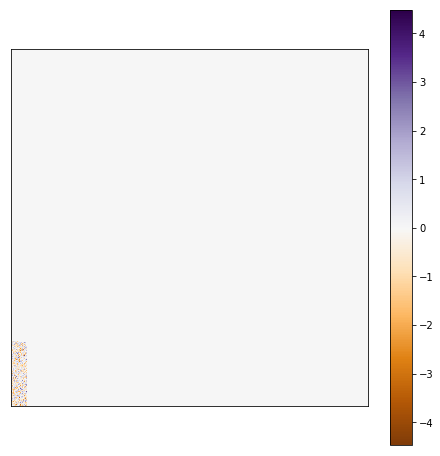

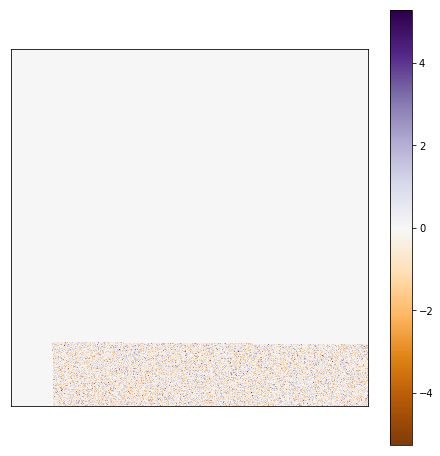

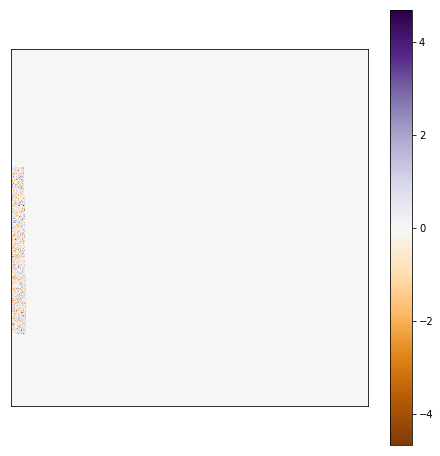

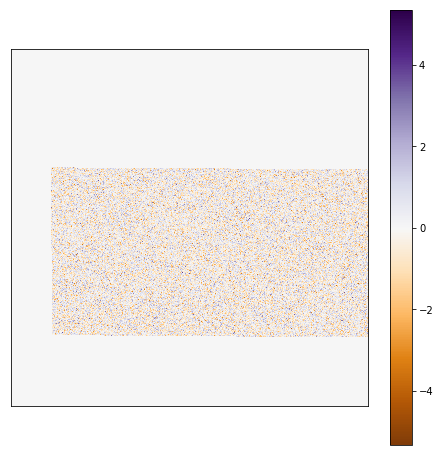

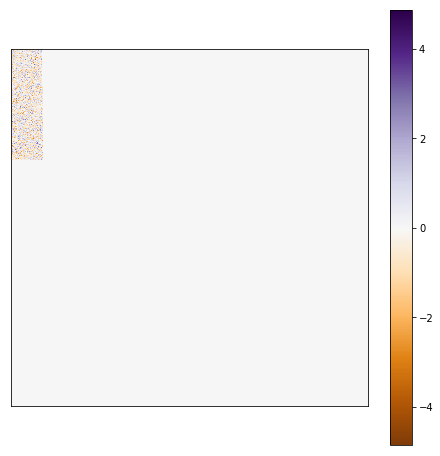

...

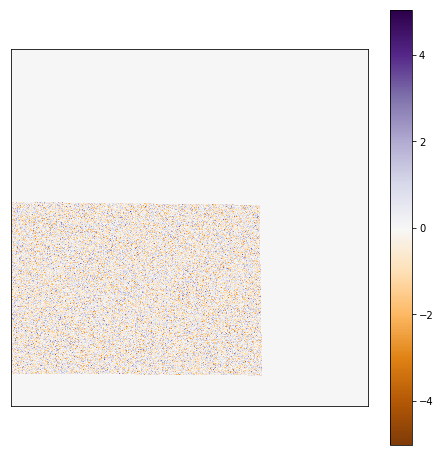

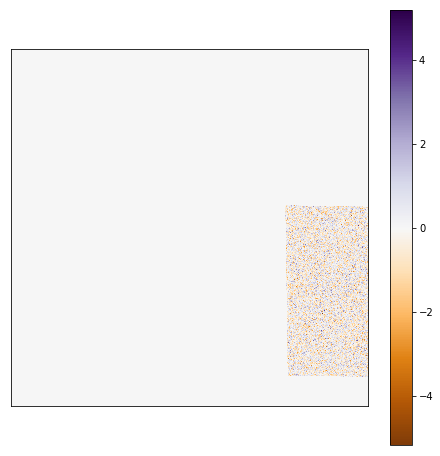

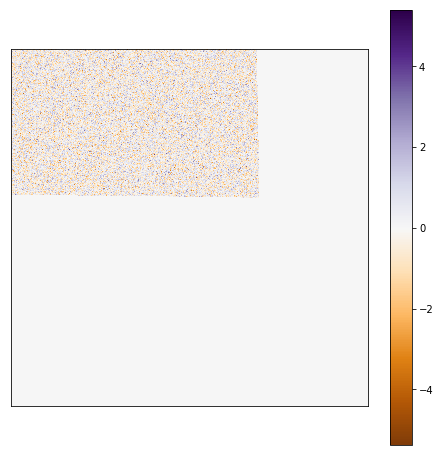

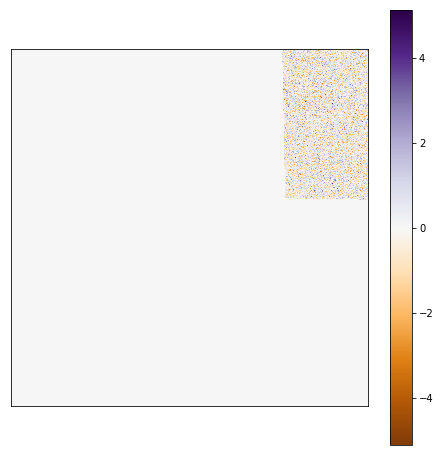

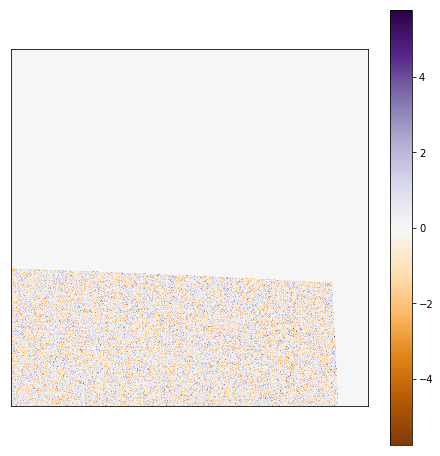

In [11]:
for warp in warp_list:
    hf.plot_func(warp, cmap=cmap, symmetrizeCmap=True)


Necessary instances for `afwMath.statisticsStack`; 
<font color='red'>**TO DO: we actually need to take some mask planes into account, otherwise all we see is how many visits into each part of the coadd**</font>

In [12]:
statsFlags = afwMath.stringToStatisticsProperty('MEAN')
statsCtrl = afwMath.StatisticsControl() # pure mean shouldn't need anything more I don't think
weightList = [1.]*len(warp_list)

In [13]:
start = time.time()
stackedNoise = afwMath.statisticsStack(warp_list, statsFlags, statsCtrl, weightList)
print('Time elapsed:\t{}s'.format(time.time()-start))

Time elapsed:	17.573936939239502s


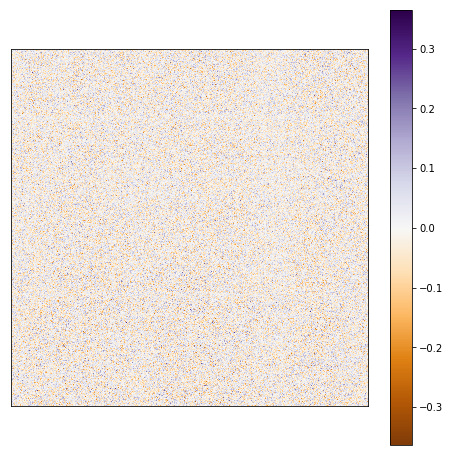

In [14]:
hf.plot_func(stackedNoise, cmap=cmap, symmetrizeCmap=True)

### Define covariance estimator

In [15]:
# all of Arun's code into a function
def makeNoiseReal(coadd, seed=None, 
                  wc=afwMath.WarpingControl(warpingKernelName=x_interpolant, interpLength=10),
                  statsFlags=afwMath.stringToStatisticsProperty('MEAN'),
                  statsCtrl=afwMath.StatisticsControl(), 
                  weightList=None):
    coaddPsf = coadd.getPsf()
    
    if seed is not None:
        np.random.seed(seed)
    
    # make calexp noise realization and warp them
    warp_list = []
    for idx in range(coaddPsf.getComponentCount()):
        xyTransform = afwGeom.makeWcsPairTransform(coaddPsf.getWcs(idx), coaddWcs)
        calexpBbox = coaddPsf.getBBox(idx)
        calexp = afwImage.ImageF(bbox=calexpBbox, initialValue=0.)
        calexp.array += np.random.randn(calexp.array.shape[0], calexp.array.shape[1])

        warp = afwImage.ImageF(bbox=coadd.getBBox()) ## supply bbox of the coadd                                                                  
        afwMath.warpImage(destImage=warp, srcImage=calexp, srcToDest=xyTransform, control=wc, padValue=0.0)

        warp_list.append(warp)
        
    # coadd them
    if weightList is None:
        weightList = [1.]*len(warp_list)
    
    return afwMath.statisticsStack(warp_list, statsFlags, statsCtrl, weightList)

In [16]:
start = time.time()
noiseReal = makeNoiseReal(deepCoadd)
print('Time elapsed:\t{}s'.format(time.time()-start))

Time elapsed:	219.17321062088013s


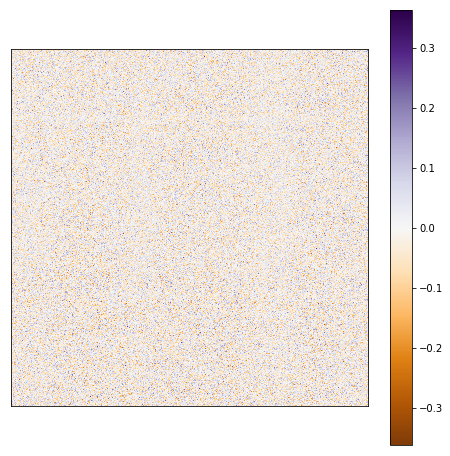

In [17]:
hf.plot_func(noiseReal, cmap=cmap, symmetrizeCmap=True)

## Adaptating Arun's local cov code:
Select how far to compute the covariance for (in both directions, for both axes):

In [18]:
howFar = 3
nbNoiseReals = 10
printCheckpoints = True

In [19]:
covariances = np.zeros((*(deepCoadd.getDimensions()),
                    2*howFar+1, 2*howFar+1)) 
print(covariances.shape, covariances.size)

(4200, 4200, 7, 7) 864360000


In [20]:
start = time.time()
for j in range(nbNoiseReals):
    startReal = time.time()
    noiseReal = makeNoiseReal(deepCoadd).array
    startCovComp = time.time()
    if printCheckpoints:
        print(' > Noise realization {} generated in {}s'.format(
              j, startCovComp-startReal))
    for xidx,dx in enumerate(range(-howFar,howFar+1)):
        noiseShiftx = np.roll(noiseReal, shift=dx, axis=1)
        for yidx,dy in enumerate(range(-howFar,howFar+1)):
            noiseShiftxy = np.roll(noiseShiftx, shift=dy, axis=0)
            covariances[:,:,xidx,yidx] += noiseShiftxy * noiseReal
    if printCheckpoints:
        print(' > Cross terms computed in {}s'.format(
              time.time()-startCovComp))
covariances /= (nbNoiseReals - 1)
print('All done in {}s'.format(time.time()-start))

 > Noise realization 0 generated in 217.92793345451355s
 > Cross terms computed in 20.12612509727478s
 > Noise realization 1 generated in 219.69527983665466s
 > Cross terms computed in 23.78919792175293s
 > Noise realization 2 generated in 218.40867042541504s
 > Cross terms computed in 28.012997150421143s
 > Noise realization 3 generated in 220.49142599105835s
 > Cross terms computed in 25.531140565872192s
 > Noise realization 4 generated in 219.22876524925232s
 > Cross terms computed in 28.67683458328247s
 > Noise realization 5 generated in 220.51691269874573s
 > Cross terms computed in 19.219183921813965s
 > Noise realization 6 generated in 218.86505103111267s
 > Cross terms computed in 20.527174711227417s
 > Noise realization 7 generated in 219.92104983329773s
 > Cross terms computed in 22.84566617012024s
 > Noise realization 8 generated in 213.67128133773804s
 > Cross terms computed in 19.501962184906006s
 > Noise realization 9 generated in 204.49466276168823s
 > Cross terms comput

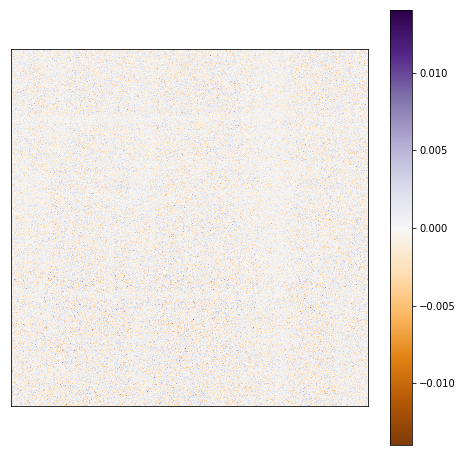

DX: -3; DY: -3


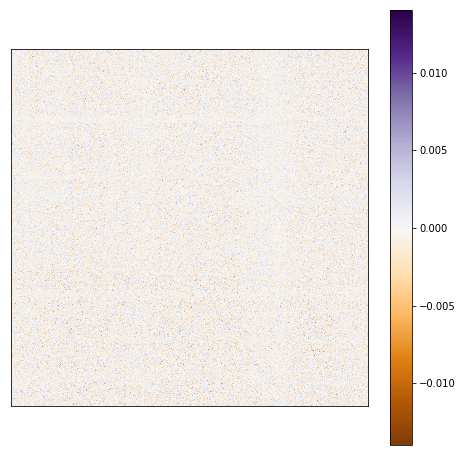

DX: -3; DY: -2


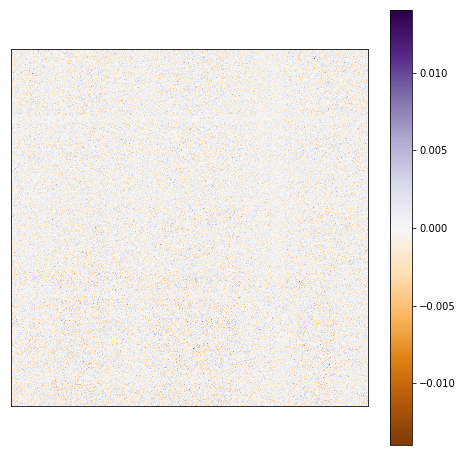

DX: -3; DY: -1


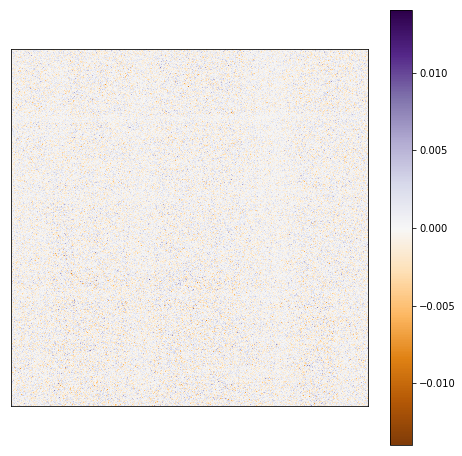

DX: -3; DY: 0


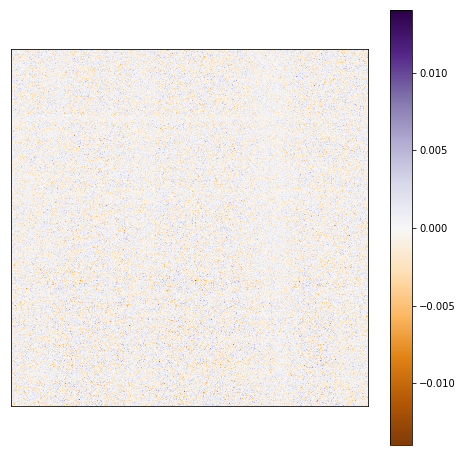

DX: -3; DY: 1


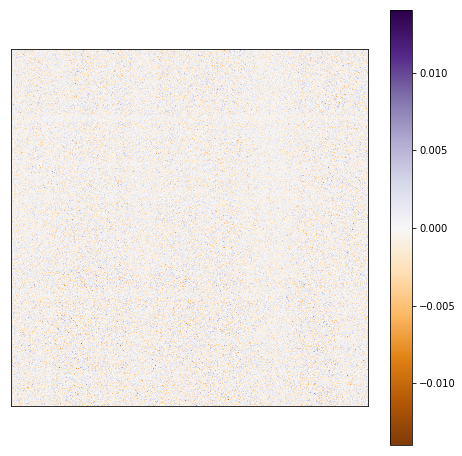

DX: -3; DY: 2


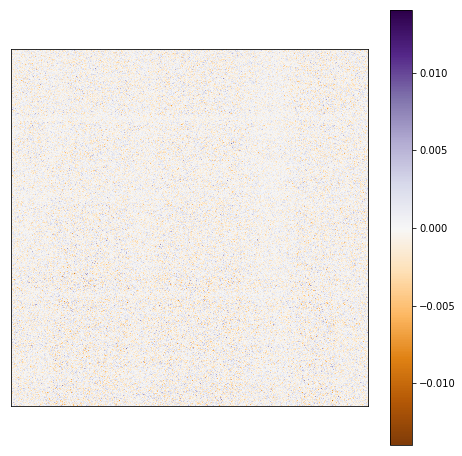

DX: -3; DY: 3


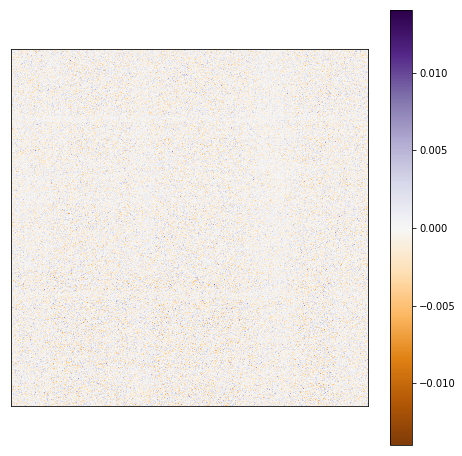

DX: -2; DY: -3


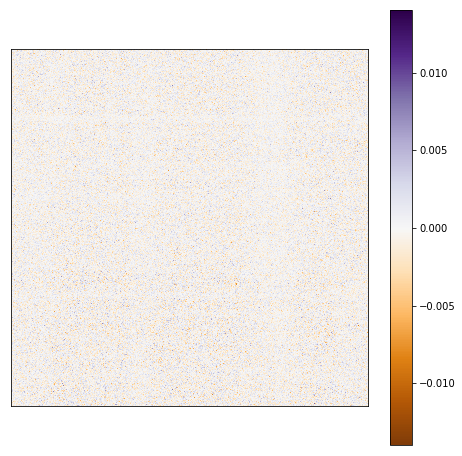

DX: -2; DY: -2


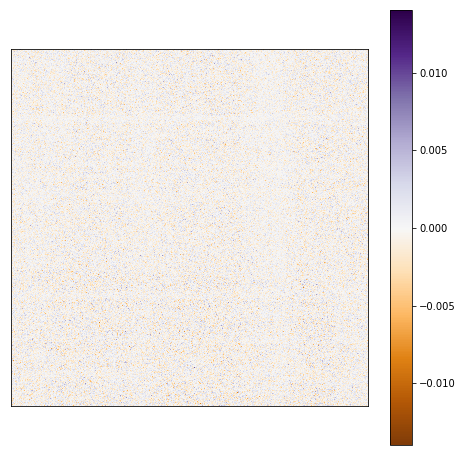

DX: -2; DY: -1


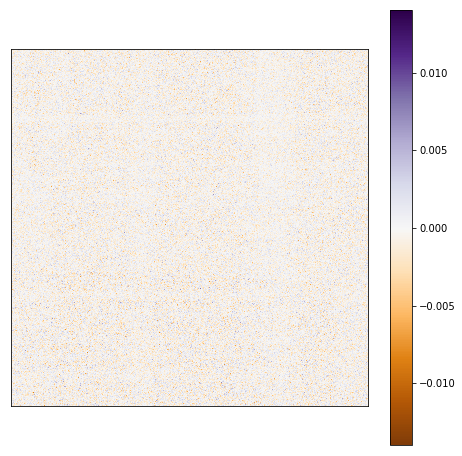

DX: -2; DY: 0


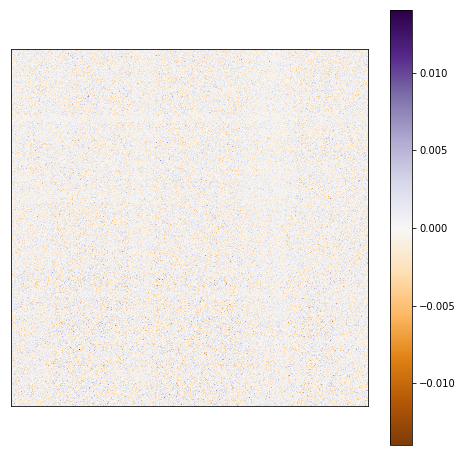

DX: -2; DY: 1


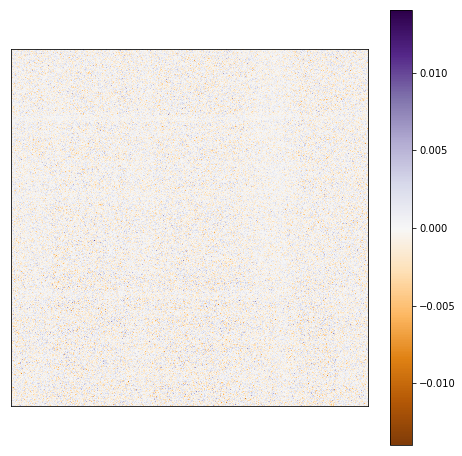

DX: -2; DY: 2


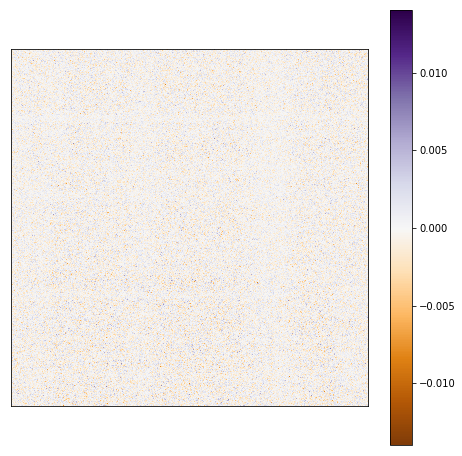

DX: -2; DY: 3


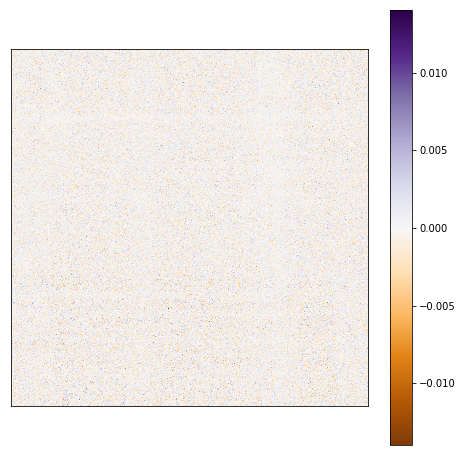

DX: -1; DY: -3


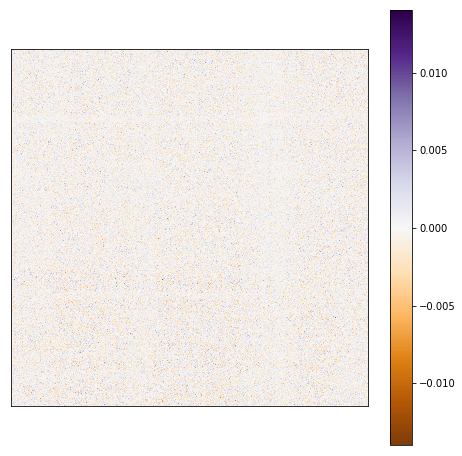

DX: -1; DY: -2


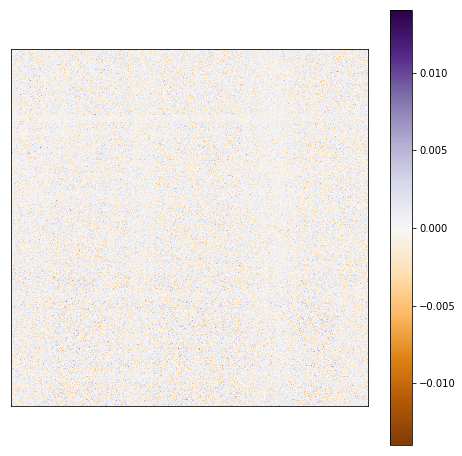

DX: -1; DY: -1


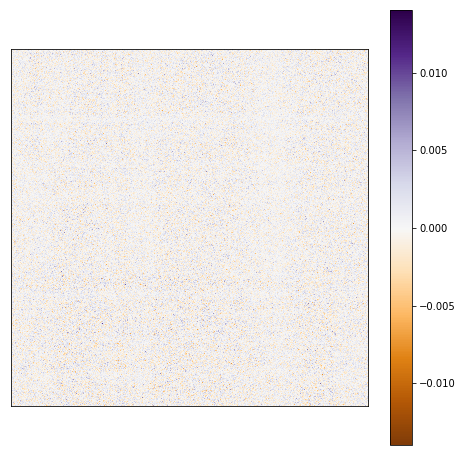

DX: -1; DY: 0


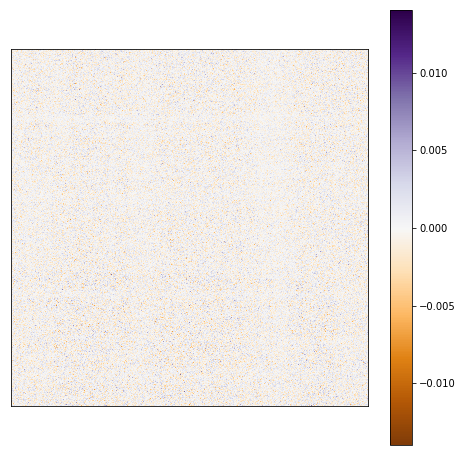

DX: -1; DY: 1


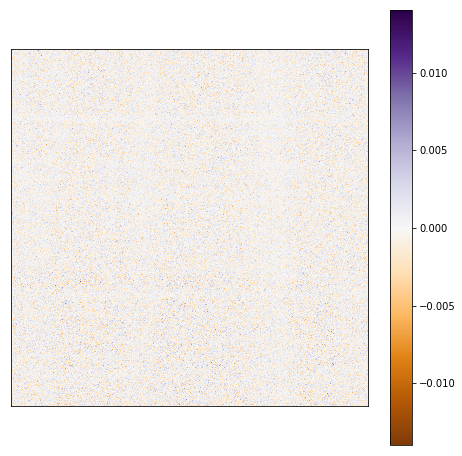

DX: -1; DY: 2


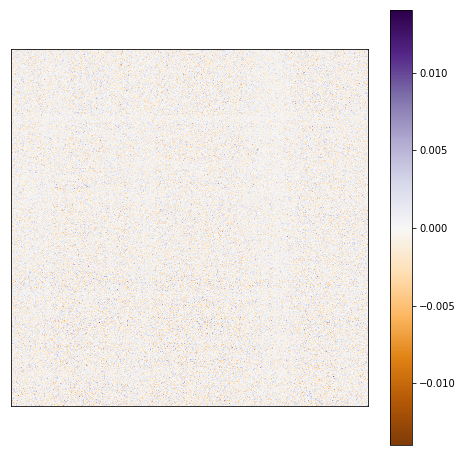

DX: -1; DY: 3


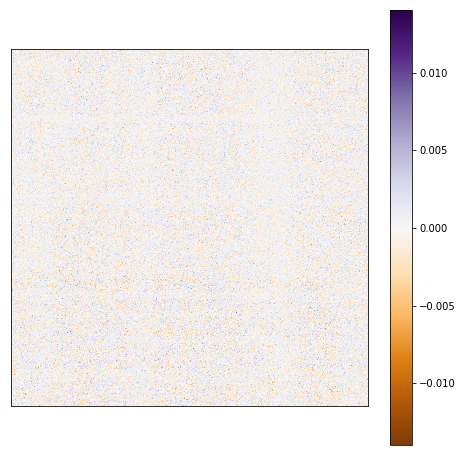

DX: 0; DY: -3


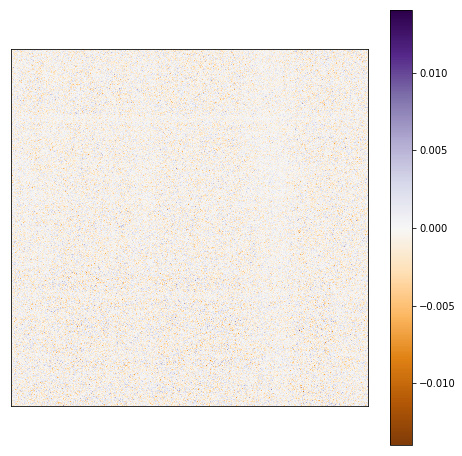

DX: 0; DY: -2


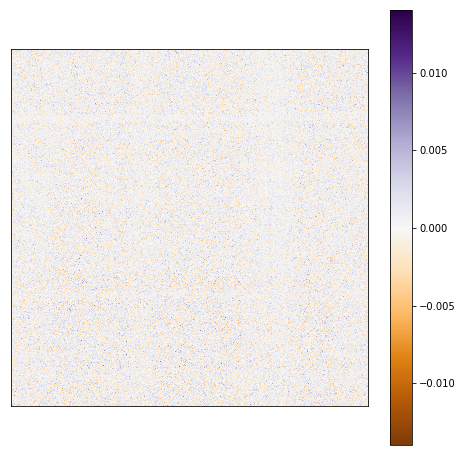

DX: 0; DY: -1


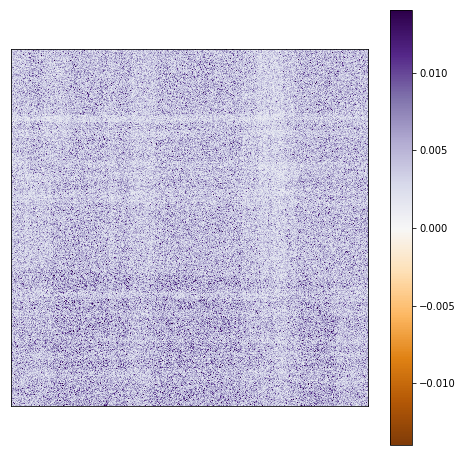

DX: 0; DY: 0


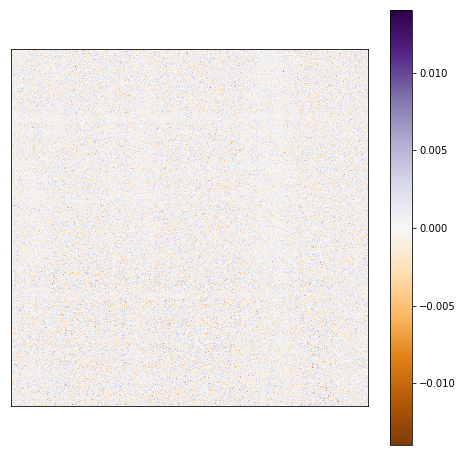

DX: 0; DY: 1


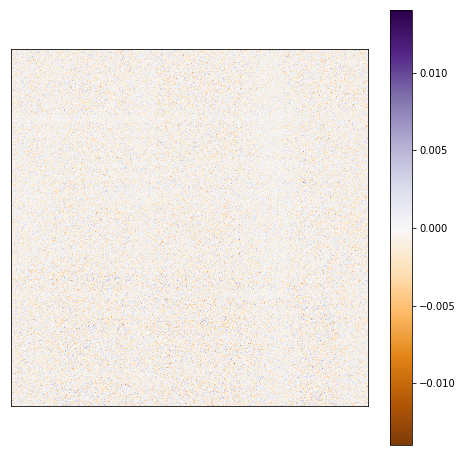

DX: 0; DY: 2


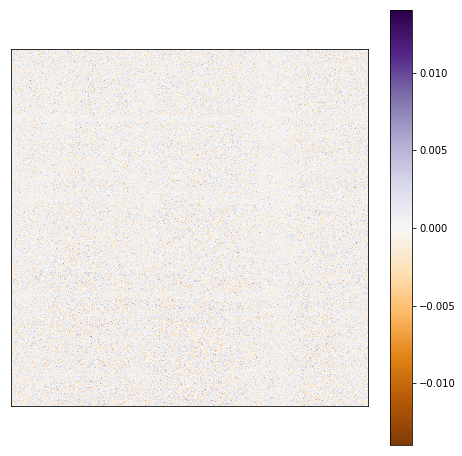

DX: 0; DY: 3


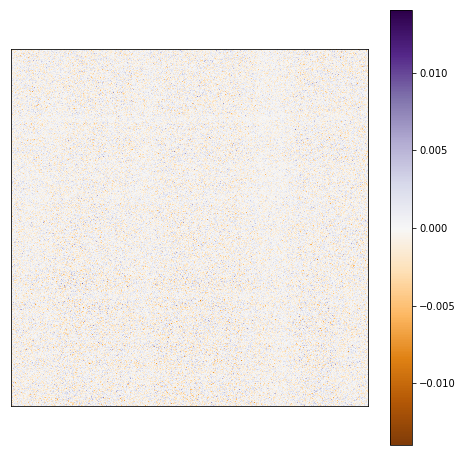

DX: 1; DY: -3


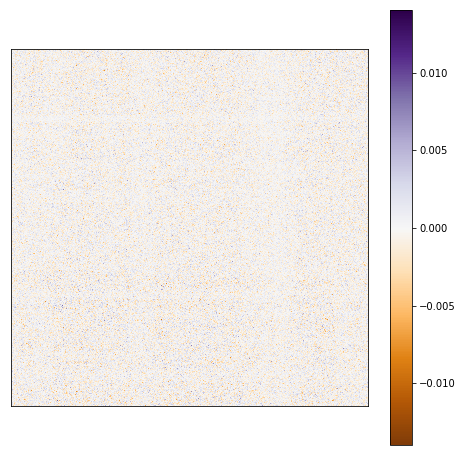

DX: 1; DY: -2


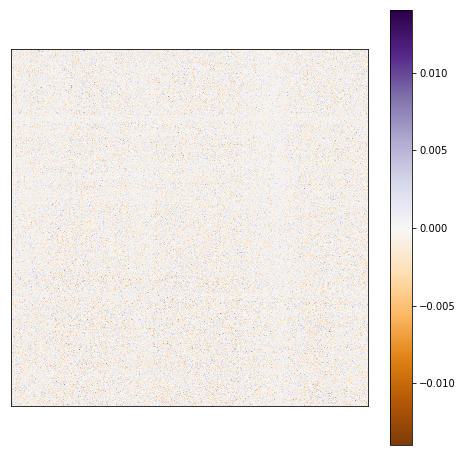

DX: 1; DY: -1


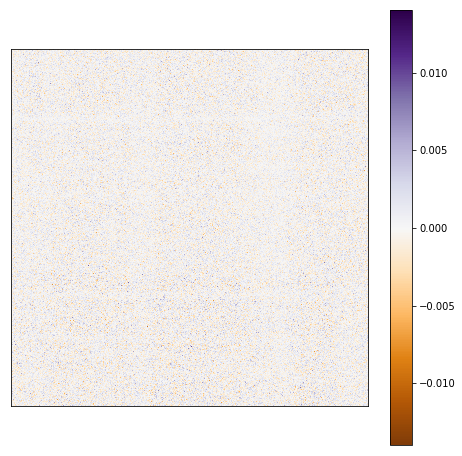

DX: 1; DY: 0


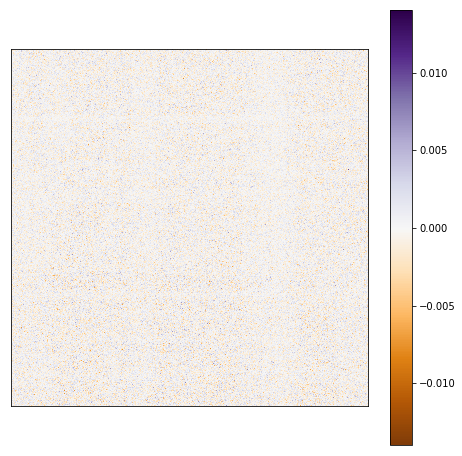

DX: 1; DY: 1


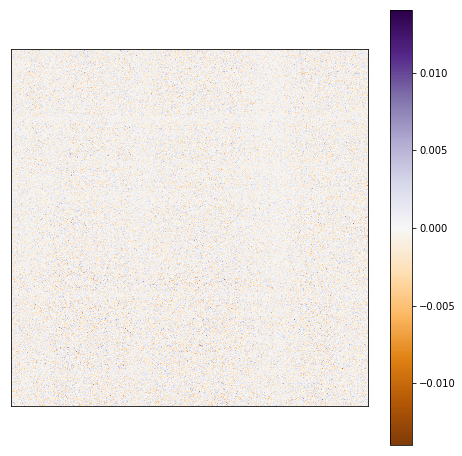

DX: 1; DY: 2


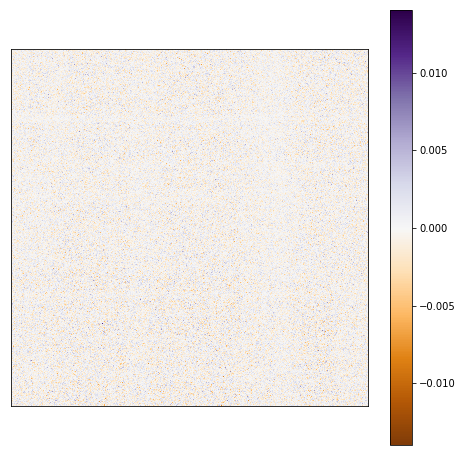

DX: 1; DY: 3


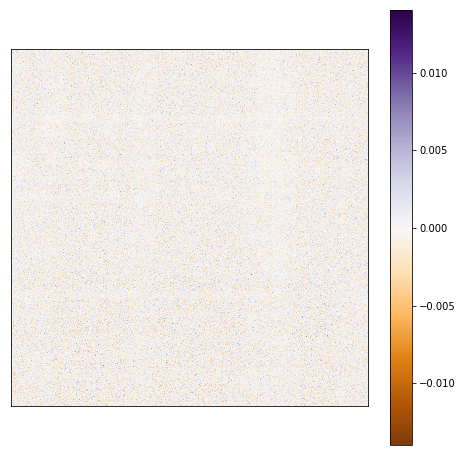

DX: 2; DY: -3


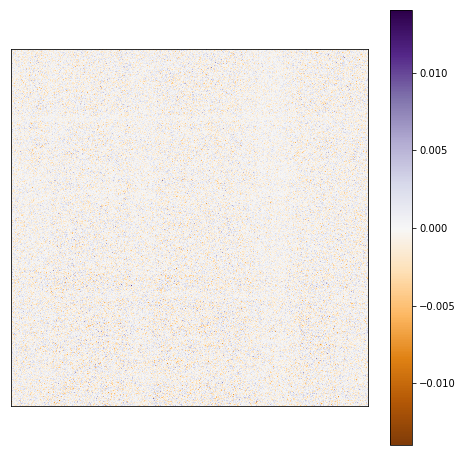

DX: 2; DY: -2


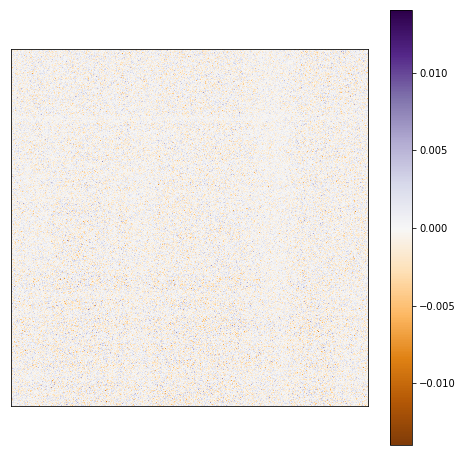

DX: 2; DY: -1


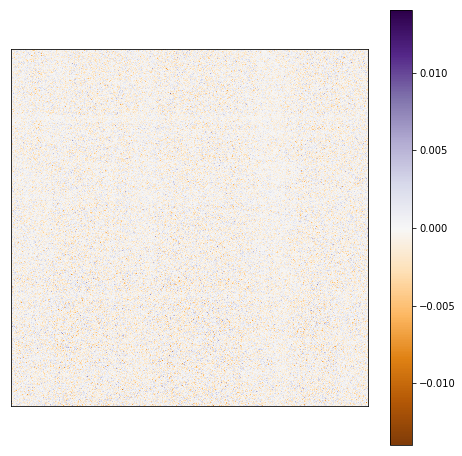

DX: 2; DY: 0


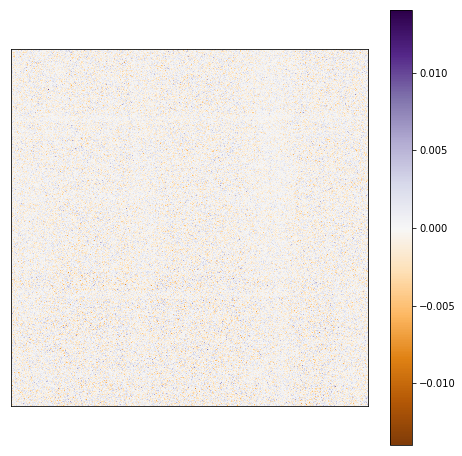

DX: 2; DY: 1


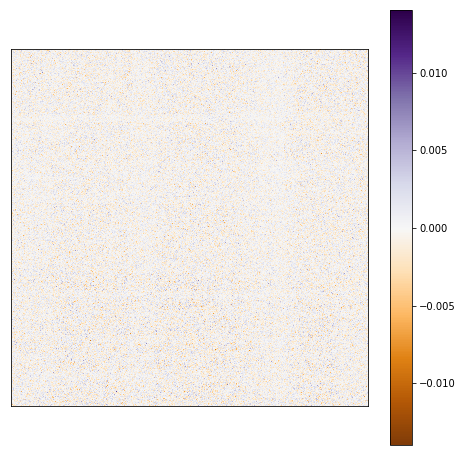

DX: 2; DY: 2


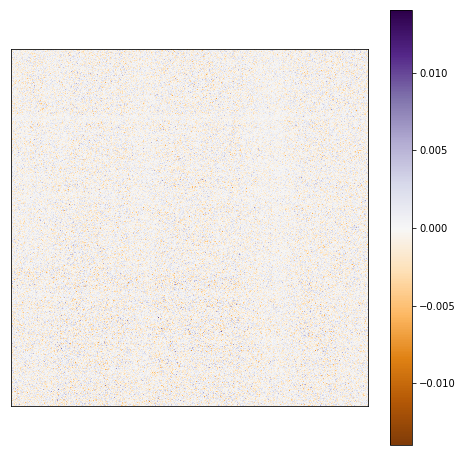

DX: 2; DY: 3


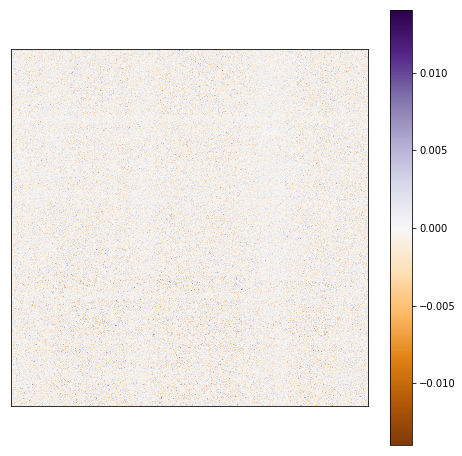

DX: 3; DY: -3


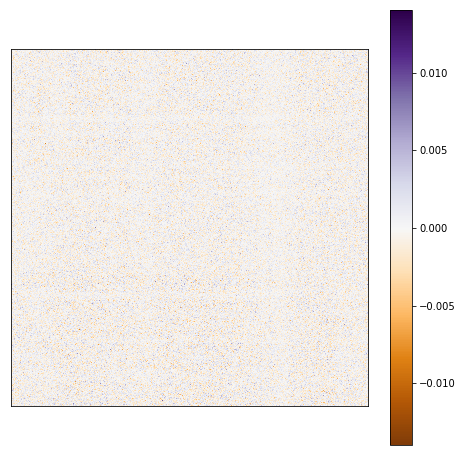

DX: 3; DY: -2


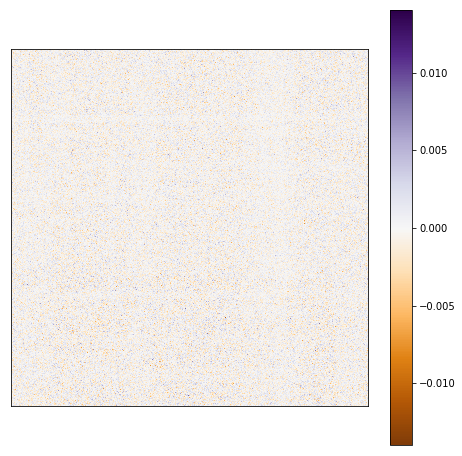

DX: 3; DY: -1


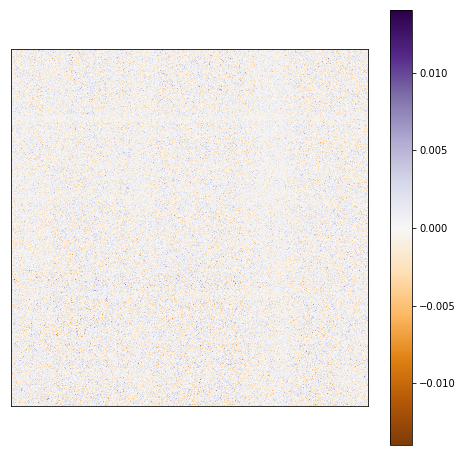

DX: 3; DY: 0


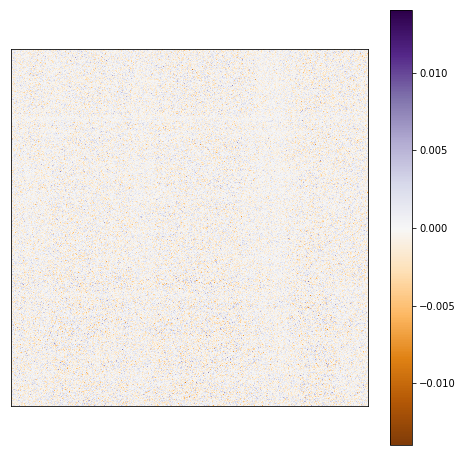

DX: 3; DY: 1


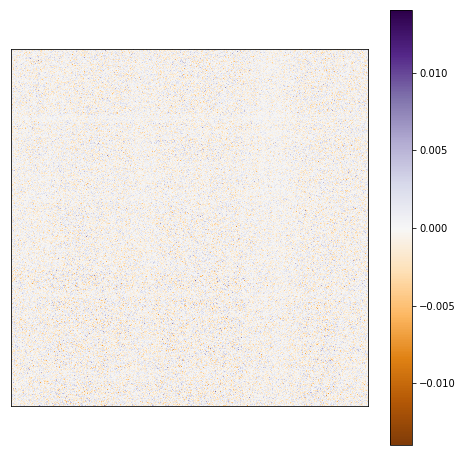

DX: 3; DY: 2


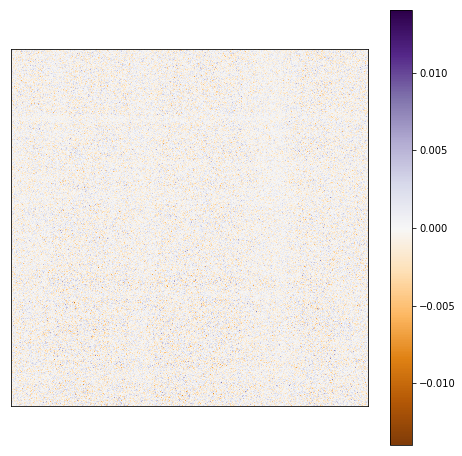

DX: 3; DY: 3


In [23]:
for xidx,dx in enumerate(range(-howFar,howFar+1)):
    for yidx,dy in enumerate(range(-howFar,howFar+1)):
        hf.plot_func(covariances[:,:,xidx,yidx], cmap=cmap, wind=(-0.014,0.014))#symmetrizeCmap=True)
        print('DX: {}; DY: {}'.format(dx,dy))

Plot a few deltas between two consecutive x-axis shifts, just as a quick representation that they're not all the same and they do already contain patterns:

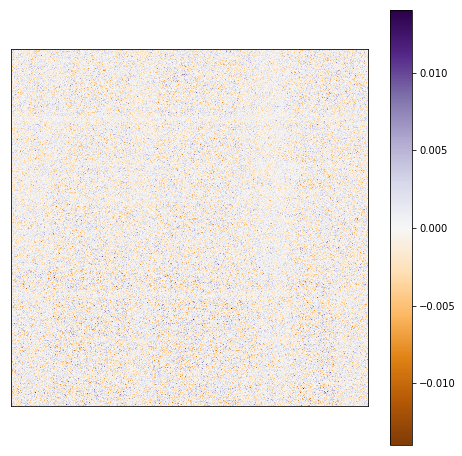

DX: -2 - -3; DY: -3


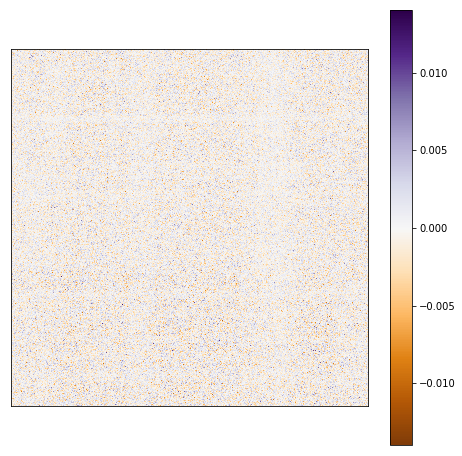

DX: -2 - -3; DY: -2


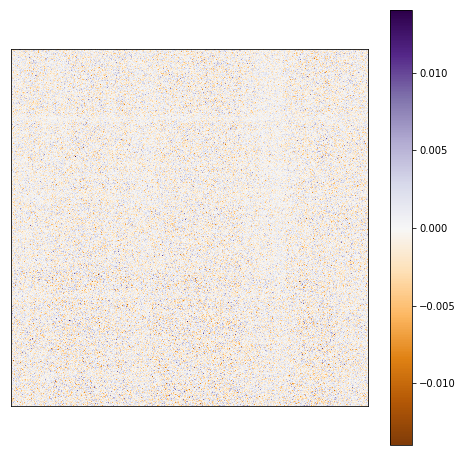

DX: -2 - -3; DY: -1


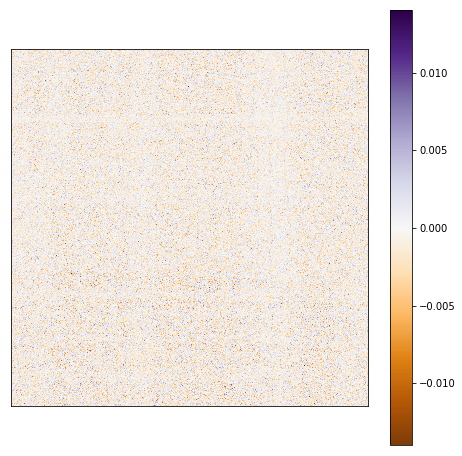

DX: -2 - -3; DY: 0


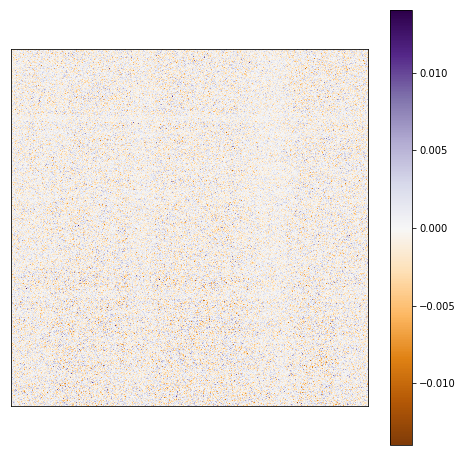

DX: -2 - -3; DY: 1


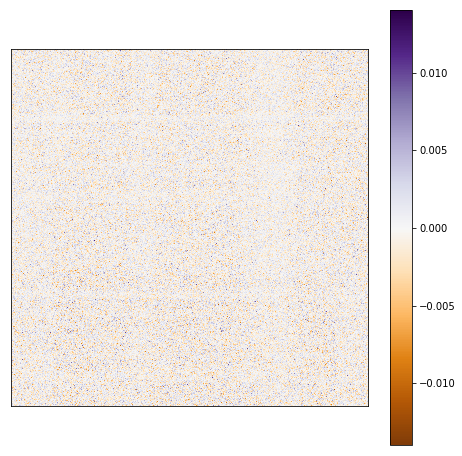

DX: -2 - -3; DY: 2


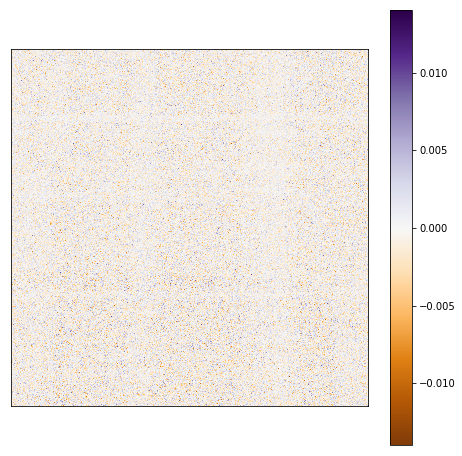

DX: -2 - -3; DY: 3


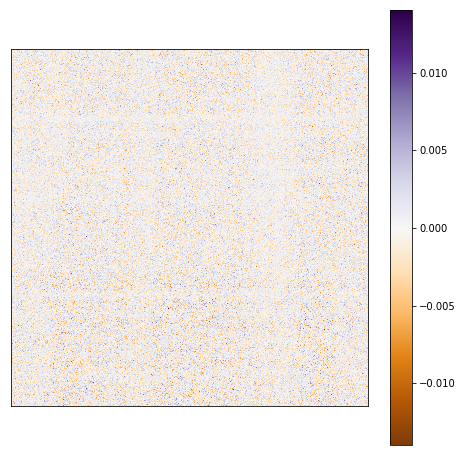

DX: -1 - -2; DY: -3


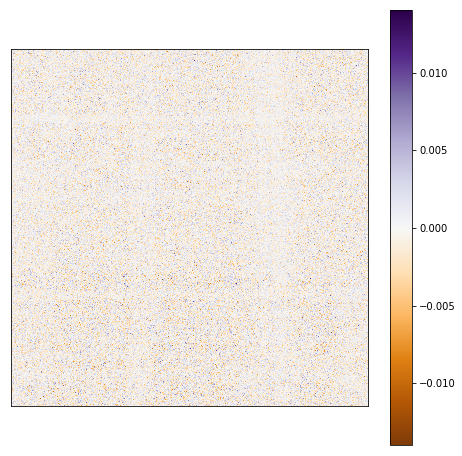

DX: -1 - -2; DY: -2


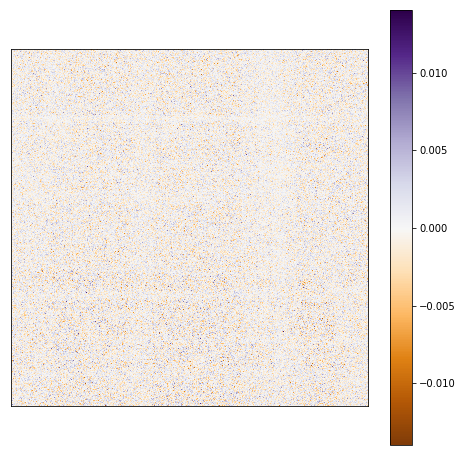

DX: -1 - -2; DY: -1


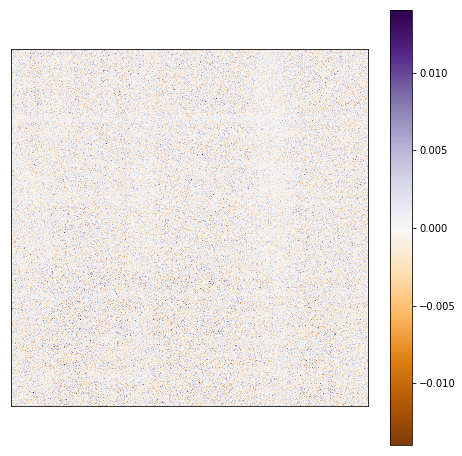

DX: -1 - -2; DY: 0


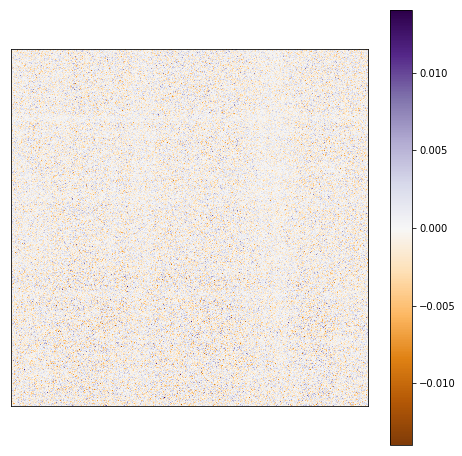

DX: -1 - -2; DY: 1


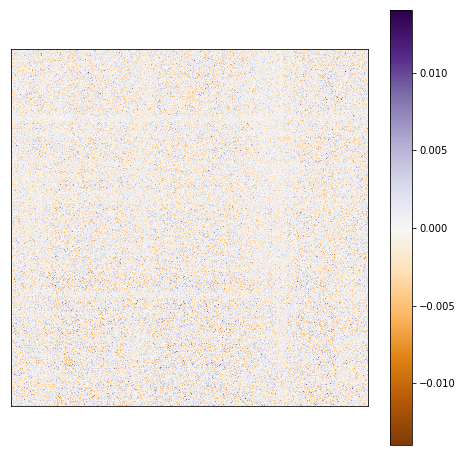

DX: -1 - -2; DY: 2


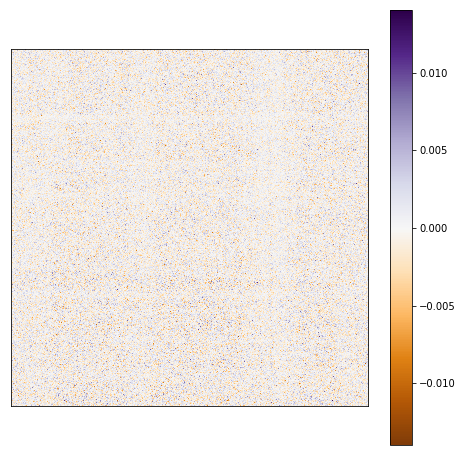

DX: -1 - -2; DY: 3


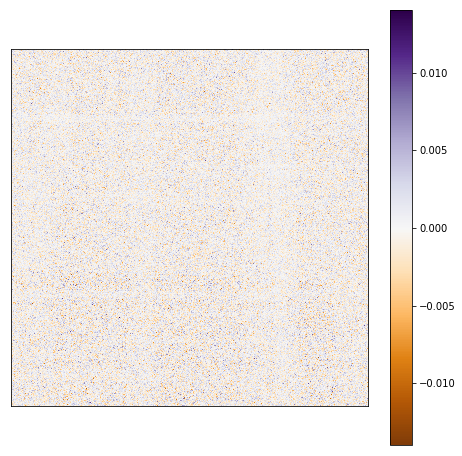

DX: 0 - -1; DY: -3


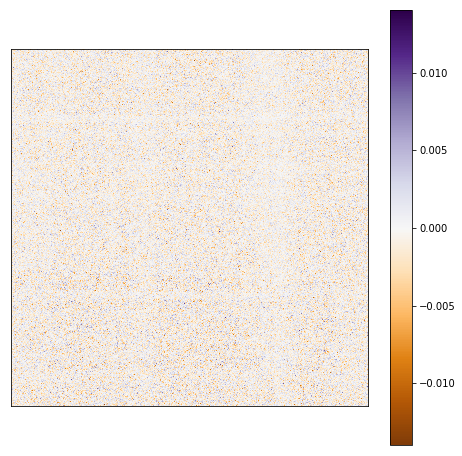

DX: 0 - -1; DY: -2


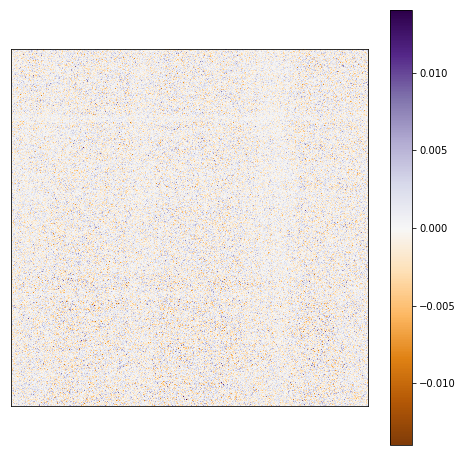

DX: 0 - -1; DY: -1


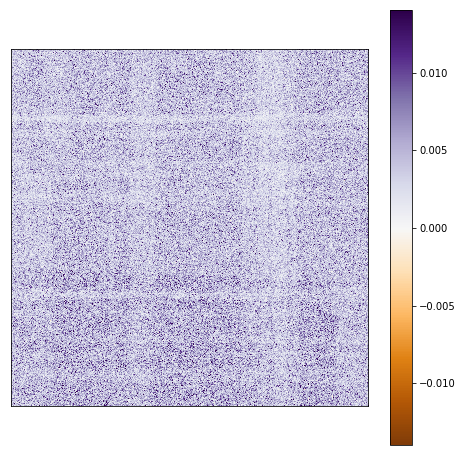

DX: 0 - -1; DY: 0


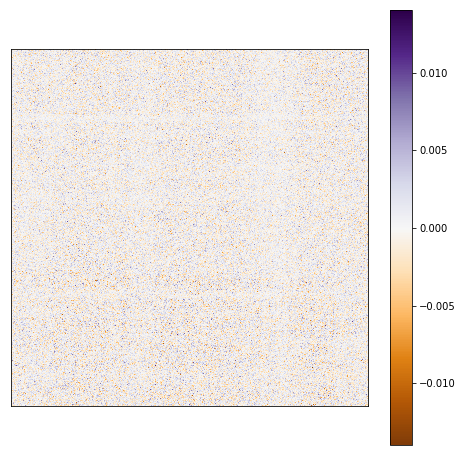

DX: 0 - -1; DY: 1


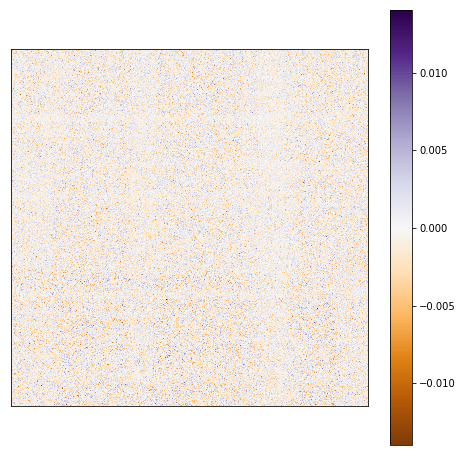

DX: 0 - -1; DY: 2


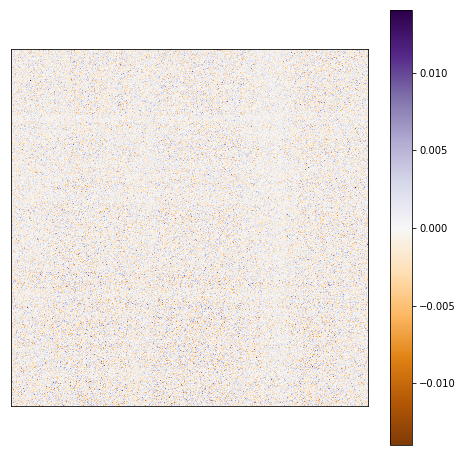

DX: 0 - -1; DY: 3


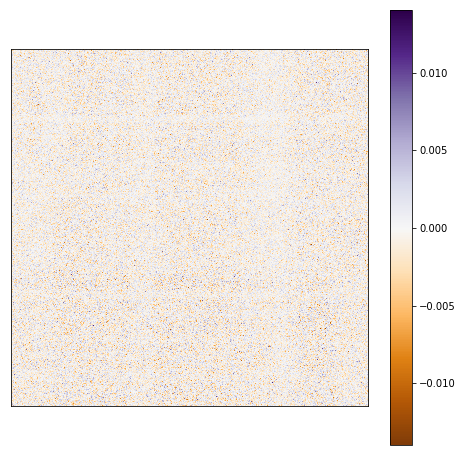

DX: 1 - 0; DY: -3


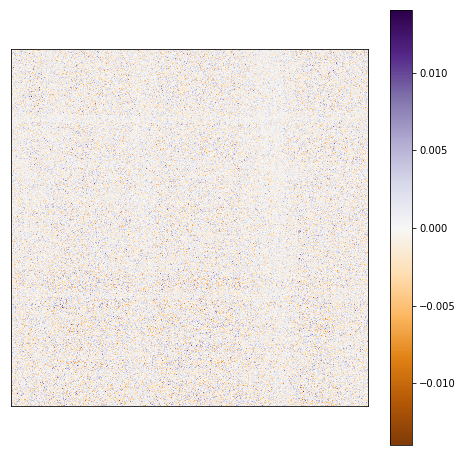

DX: 1 - 0; DY: -2


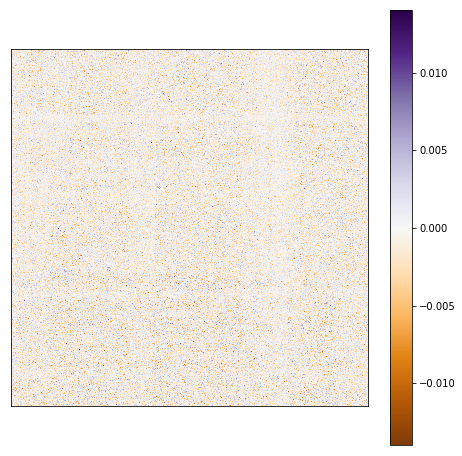

DX: 1 - 0; DY: -1


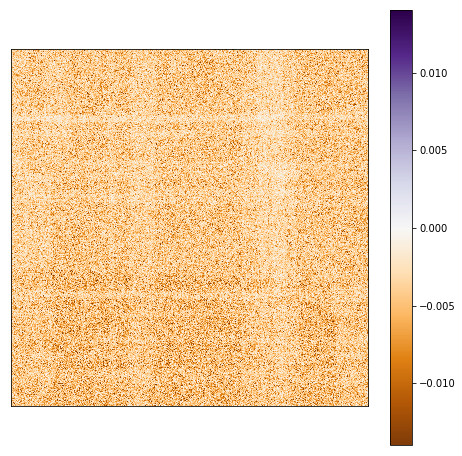

DX: 1 - 0; DY: 0


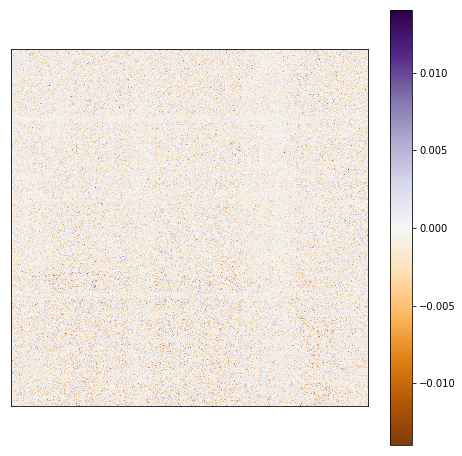

DX: 1 - 0; DY: 1


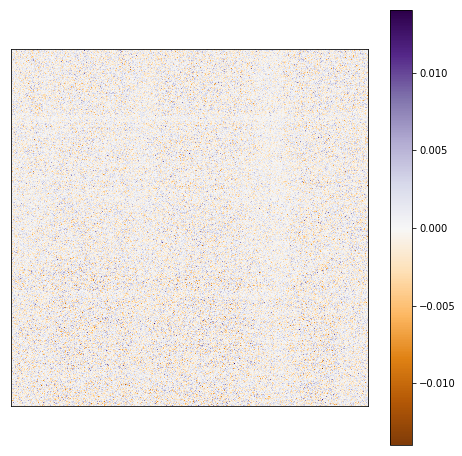

DX: 1 - 0; DY: 2


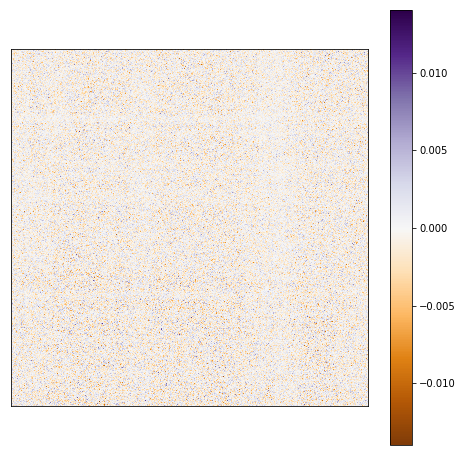

DX: 1 - 0; DY: 3


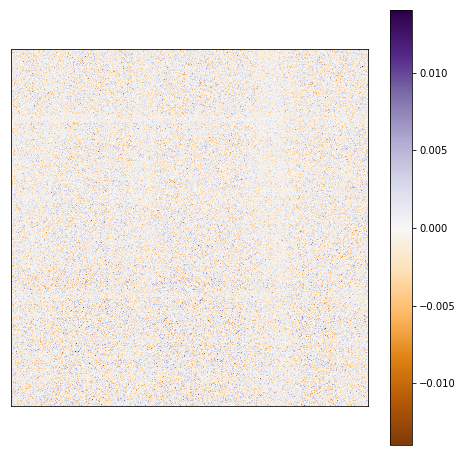

DX: 2 - 1; DY: -3


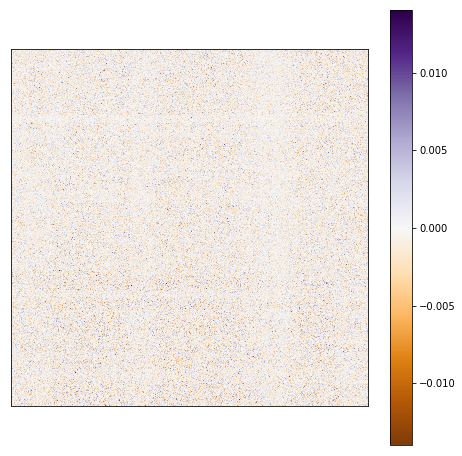

DX: 2 - 1; DY: -2


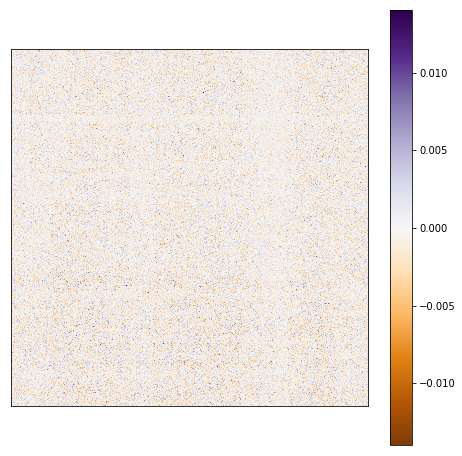

DX: 2 - 1; DY: -1


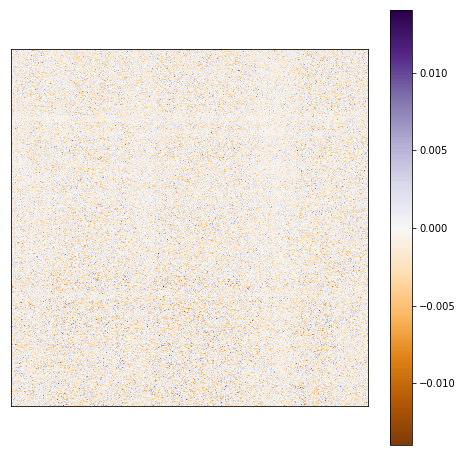

DX: 2 - 1; DY: 0


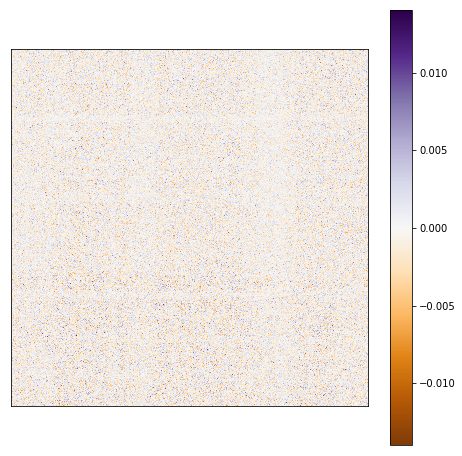

DX: 2 - 1; DY: 1


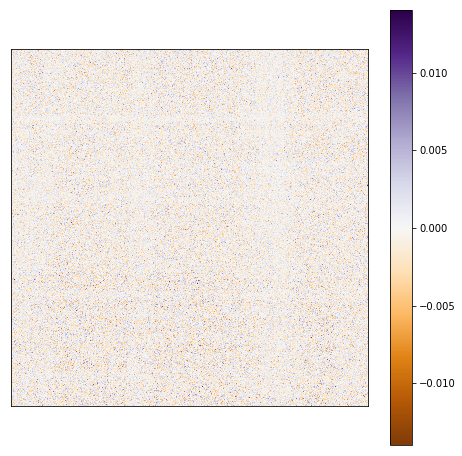

DX: 2 - 1; DY: 2


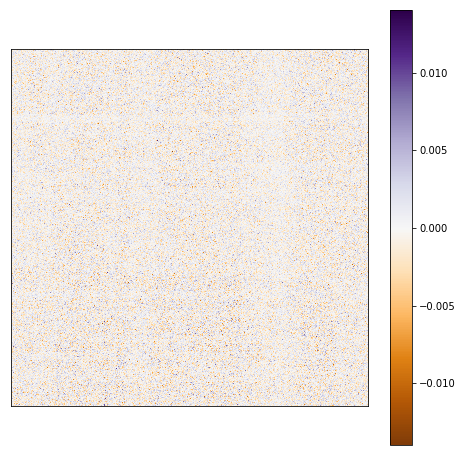

DX: 2 - 1; DY: 3


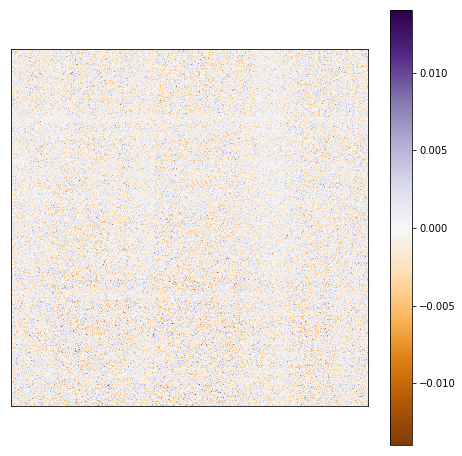

DX: 3 - 2; DY: -3


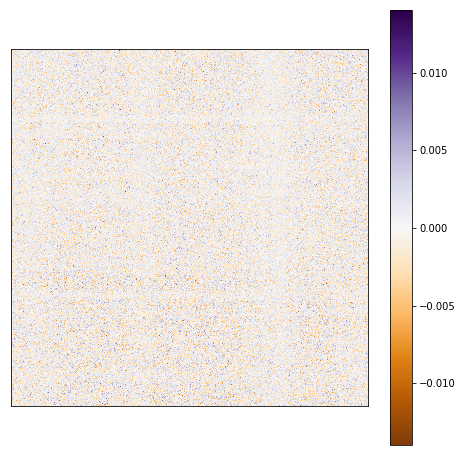

DX: 3 - 2; DY: -2


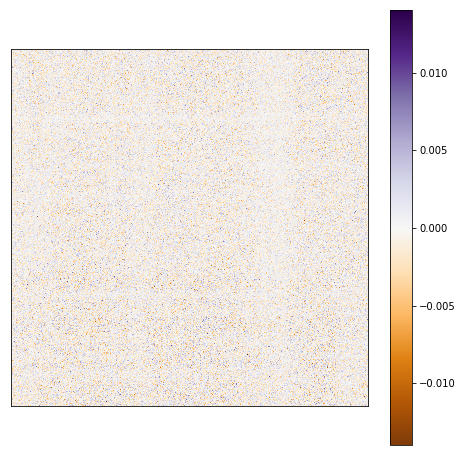

DX: 3 - 2; DY: -1


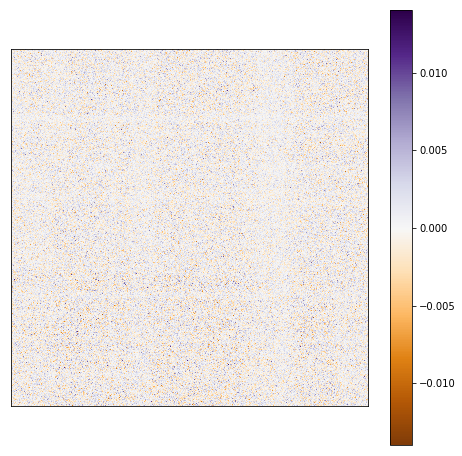

DX: 3 - 2; DY: 0


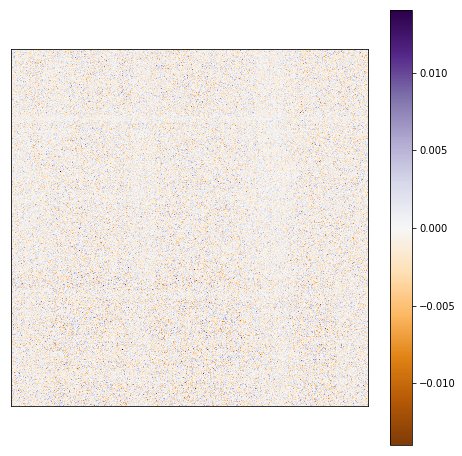

DX: 3 - 2; DY: 1


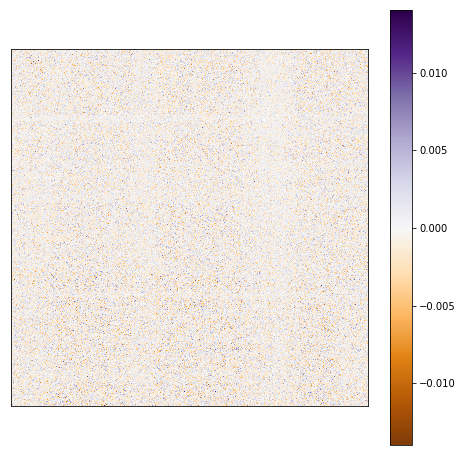

DX: 3 - 2; DY: 2


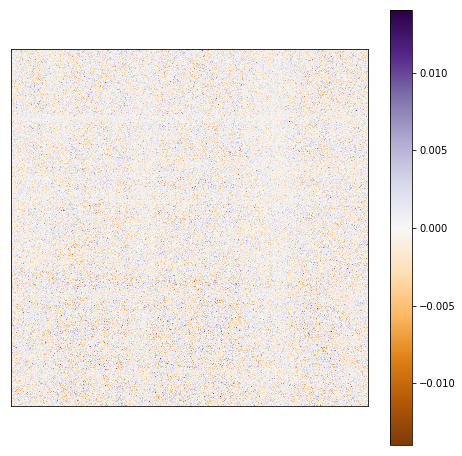

DX: 3 - 2; DY: 3


In [24]:
for xidx,dx in enumerate(range(-howFar,howFar+1)):
    for yidx,dy in enumerate(range(-howFar,howFar+1)):
        if not xidx:
            continue
        hf.plot_func(covariances[:,:,xidx,yidx]-covariances[:,:,xidx-1,yidx], cmap=cmap, wind=(-0.014,0.014))
        print('DX: {} - {}; DY: {}'.format(dx,dx-1,dy))